In [136]:
import json
import collections
from itertools import combinations, product
from database import get_conn
from datetime import date
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import norm, t
import seaborn as sns
from seaborn_qqplot import pplot
from ydata_profiling import ProfileReport
import networkx as nx

from statsmodels.tsa.seasonal import MSTL, DecomposeResult
import statsmodels.api as sm
from sklearn.linear_model import HuberRegressor, LinearRegression, ElasticNet, BayesianRidge

import pymc as pm
import bambi as bmb
import arviz as az

from tqdm.notebook import tqdm

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


# Roughly inspect some datasets

In [2]:
pd.read_sql_table('HIS_PROJECT_PATINFO',get_conn()).info()

In [3]:
pd.read_sql_table('HIS_PROJECT_OPDHEADER',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2919256 entries, 0 to 2919255
Data columns (total 15 columns):
 #   Column               Dtype         
---  ------               -----         
 0   VisitDate            datetime64[ns]
 1   VN                   object        
 2   PrescriptionNo       int64         
 3   HN                   object        
 4   NewToHere            int64         
 5   NewPatient           int64         
 6   Doctor               object        
 7   VisitCode            object        
 8   CloseVisitCode       object        
 9   RightCode            object        
 10  AppointmentNo        object        
 11  AppointmentDateTime  datetime64[ns]
 12  InDateTime           datetime64[ns]
 13  OutDateTime          datetime64[ns]
 14  SpecialtyClinic      object        
dtypes: datetime64[ns](4), int64(3), object(8)
memory usage: 334.1+ MB


In [4]:
pd.read_sql_table('HIS_PROJECT_OPDDIAG',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3852524 entries, 0 to 3852523
Data columns (total 17 columns):
 #   Column               Dtype         
---  ------               -----         
 0   VisitDate            datetime64[ns]
 1   VN                   object        
 2   PrescriptionNo       int64         
 3   SuffixSmall          int64         
 4   ICDCode              object        
 5   ECode                object        
 6   IcdCmCode1           object        
 7   IcdCmCode2           object        
 8   IcdCmCode3           object        
 9   IcdCmCode4           object        
 10  IcdCmCode5           object        
 11  IcdCmCode6           object        
 12  IcdCmCode7           object        
 13  IcdCmCode8           object        
 14  IcdCmCode9           object        
 15  IcdCmCode10          object        
 16  DiagnosisRecordType  int64         
dtypes: datetime64[ns](1), int64(3), object(13)
memory usage: 499.7+ MB


In [5]:
pd.read_sql_table('HIS_PROJECT_OPDDISEASE',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1826997 entries, 0 to 1826996
Data columns (total 7 columns):
 #   Column               Dtype         
---  ------               -----         
 0   VisitDate            datetime64[ns]
 1   VN                   object        
 2   PrescriptionNo       int64         
 3   SuffixSmall          int64         
 4   DiseaseCode          object        
 5   DiagnosisRecordType  int64         
 6   RemarksMemo          object        
dtypes: datetime64[ns](1), int64(3), object(3)
memory usage: 97.6+ MB


In [6]:
pd.read_sql_table('HIS_PROJECT_OPDRECEIVE',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2696418 entries, 0 to 2696417
Data columns (total 12 columns):
 #   Column                Dtype         
---  ------                -----         
 0   VisitDate             datetime64[ns]
 1   VN                    object        
 2   ReceiptSuffixTiny     int64         
 3   ReceiptNo             object        
 4   ReceiveDateTime       datetime64[ns]
 5   ARCode                object        
 6   CashierFacilityRmsNo  object        
 7   TransferToRefNo       object        
 8   FromChargeAmt         float64       
 9   DiscountAmt           float64       
 10  DiscountCashAmt       float64       
 11  PayCashAmt            float64       
dtypes: datetime64[ns](2), float64(4), int64(1), object(5)
memory usage: 246.9+ MB


In [7]:
pd.read_sql_table('HIS_MASTER_ICD',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41972 entries, 0 to 41971
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   IcdCode        41972 non-null  object
 1   EnglishName    41972 non-null  object
 2   IcdCodeOrg     34454 non-null  object
 3   OrganCode      0 non-null      object
 4   OrganPosition  0 non-null      object
 5   RemarksMemo    2699 non-null   object
dtypes: object(6)
memory usage: 1.9+ MB


In [8]:
pd.read_sql_table('HIS_MASTER_ICDCM',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4542 entries, 0 to 4541
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   IcdCmCode         4542 non-null   object
 1   EnglishName       4542 non-null   object
 2   LocalName         2 non-null      object
 3   RemarksMemo       977 non-null    object
 4   Off_ICDCM_MASTER  4542 non-null   int64 
dtypes: int64(1), object(4)
memory usage: 177.6+ KB


In [9]:
pd.read_sql_table('HIS_MASTER_DOCTOR',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1345 entries, 0 to 1344
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Doctor               1345 non-null   object 
 1   EnglishName          1260 non-null   object 
 2   LocalName            1345 non-null   object 
 3   DoctorCategoryGroup  359 non-null    object 
 4   Specialty            1110 non-null   object 
 5   PayrollNo            786 non-null    object 
 6   CertifyPublicNo      1166 non-null   object 
 7   RplGlAccCode         0 non-null      object 
 8   ComposeDept          94 non-null     object 
 9   Clinic               561 non-null    object 
 10  HNDoctorType         1224 non-null   float64
 11  Inactive             1326 non-null   float64
 12  DoctorCategory       0 non-null      object 
dtypes: float64(2), object(11)
memory usage: 136.7+ KB


In [10]:
pd.read_sql_table('HIS_MASTER_CLINIC',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 0 entries
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   ClinicCode   0 non-null      object
 1   ClinicName   0 non-null      object
 2   DRGCode      0 non-null      object
 3   ClinicGroup  0 non-null      object
 4   Location     0 non-null      object
dtypes: object(5)
memory usage: 132.0+ bytes


In [11]:
pd.read_sql_table('HIS_MASTER_DISCHARGETYPE',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 0 entries
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Type       0 non-null      int64 
 1   Code       0 non-null      int64 
 2   LocalName  0 non-null      object
 3   DRGCode    0 non-null      object
dtypes: int64(2), object(2)
memory usage: 132.0+ bytes


In [14]:
pd.read_sql_table('HIS_MASTER_ENUM',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 0 entries
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Group_ID    0 non-null      int64 
 1   Code        0 non-null      int64 
 2   Group_Name  0 non-null      object
 3   Code_Name   0 non-null      object
dtypes: int64(2), object(2)
memory usage: 132.0+ bytes


In [12]:
pd.read_sql_table('HIS_MASTER_LABCODE',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2908 entries, 0 to 2907
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   LabCode            2908 non-null   object 
 1   EnglishName        2908 non-null   object 
 2   LocalName          2886 non-null   object 
 3   DefaultPrice       2884 non-null   float64
 4   HNActivityCode     2884 non-null   object 
 5   DefaultOutsideLab  2884 non-null   object 
 6   CanBeZeroPrice     2877 non-null   float64
 7   Inactive           2880 non-null   float64
 8   GroupOfLab         2884 non-null   object 
 9   SpecimenCode       2884 non-null   object 
 10  LabSpecimenMethod  2884 non-null   object 
 11  FacilityRmsNo      2884 non-null   object 
 12  CGDCode            2871 non-null   object 
 13  GFPrice            2871 non-null   float64
dtypes: float64(4), object(10)
memory usage: 318.2+ KB


In [15]:
pd.read_sql_table('HIS_MASTER_GROUPBILL',get_conn()).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 0 entries
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Code       0 non-null      object
 1   Claim      0 non-null      object
 2   LocalName  0 non-null      object
 3   MapBill    0 non-null      object
dtypes: object(4)
memory usage: 132.0+ bytes


# Dump database with some modifications

In [30]:
patient_info_df=pd.read_sql_query("""
select *
from HIS_PROJECT_PATINFO
where BirthDateTime<FirstDateTime
and BirthDateTime<MakeDateTime
and FirstDateTime<=MakeDateTime
and ((DeadDateTime is null) or ((BirthDateTime<DeadDateTime) and (MakeDateTime<=DeadDateTime) and (DeadDateTime < getdate())))
and ((DeadDateTime is null) or (datediff(year,BirthDateTime,DeadDateTime))<=100)
and ((DeadDateTime is not null) or (datediff(year,BirthDateTime,getdate()))<=100)
and Gender <=2
and NationalityCode is not null
and MaritalStatus is not null
and UPPER([HN]) NOT LIKE '%TEST%' 
AND UPPER([HN]) NOT LIKE '%YY%'
and LEN([HN])>7
""",get_conn(),index_col='HN')
patient_info_df.to_parquet("input_data/patient_info.parquet")
patient_info_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 357552 entries, 530043094 to 530043087
Data columns (total 7 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   MakeDateTime     357552 non-null  datetime64[ns]
 1   FirstDateTime    357552 non-null  datetime64[ns]
 2   BirthDateTime    357552 non-null  datetime64[ns]
 3   DeadDateTime     5668 non-null    datetime64[ns]
 4   Gender           357552 non-null  int64         
 5   MaritalStatus    357552 non-null  object        
 6   NationalityCode  357552 non-null  object        
dtypes: datetime64[ns](4), int64(1), object(2)
memory usage: 29.9+ MB


In [12]:
pd.read_sql_query("""
select *
from HIS_PROJECT_PATINFO
where BirthDateTime<FirstDateTime
and BirthDateTime<MakeDateTime
and FirstDateTime<=MakeDateTime
and ((DeadDateTime is null) or ((BirthDateTime<DeadDateTime) and (DeadDateTime < getdate())))
and datediff(year,BirthDateTime,getdate())>=18
and Gender <=2
and NationalityCode is not null
and MaritalStatus is not null
""",get_conn(),index_col='HN').info()

<class 'pandas.core.frame.DataFrame'>
Index: 357871 entries, 530043094 to 530043087
Data columns (total 7 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   MakeDateTime     357871 non-null  datetime64[ns]
 1   FirstDateTime    357871 non-null  datetime64[ns]
 2   BirthDateTime    357871 non-null  datetime64[ns]
 3   DeadDateTime     5693 non-null    datetime64[ns]
 4   Gender           357871 non-null  int64         
 5   MaritalStatus    357871 non-null  object        
 6   NationalityCode  357871 non-null  object        
dtypes: datetime64[ns](4), int64(1), object(2)
memory usage: 21.8+ MB


In [80]:
opd_header_df=pd.read_sql_query("""
select [VisitDate]
      ,[VN]
      ,[PrescriptionNo]
      ,TRIM([HN]) as HN
      ,[NewToHere]
      ,[NewPatient]
      ,[Doctor]
      ,[VisitCode]
      ,[CloseVisitCode]
      ,[RightCode]
      ,[AppointmentNo]
      ,[AppointmentDateTime]
      ,[InDateTime]
      ,[OutDateTime]
      ,[SpecialtyClinic]
from HIS_PROJECT_OPDHEADER
where OutDateTime is not null
and InDateTime<=OutDateTime
and InDateTime >= '2018/05/01' and InDateTime <= '2023/06/30'
and VisitCode is not null
and CloseVisitCode is not null                              
""",get_conn(),index_col=['VisitDate','VN','PrescriptionNo'])
opd_header_df.to_parquet("input_data/opd_header_df.parquet")
opd_header_df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 1827010 entries, (Timestamp('2018-05-01 00:00:00'), '1012', 1) to (Timestamp('2023-06-27 00:00:00'), '0001', 1)
Data columns (total 12 columns):
 #   Column               Dtype         
---  ------               -----         
 0   HN                   object        
 1   NewToHere            int64         
 2   NewPatient           int64         
 3   Doctor               object        
 4   VisitCode            object        
 5   CloseVisitCode       object        
 6   RightCode            object        
 7   AppointmentNo        object        
 8   AppointmentDateTime  datetime64[ns]
 9   InDateTime           datetime64[ns]
 10  OutDateTime          datetime64[ns]
 11  SpecialtyClinic      object        
dtypes: datetime64[ns](3), int64(2), object(7)
memory usage: 176.2+ MB


In [4]:
opd_diag_df=pd.read_sql_query("""
select *
from HIS_PROJECT_OPDDIAG                
where ICDCode is not null
""",get_conn(),index_col=['VisitDate','VN','PrescriptionNo','SuffixSmall'])
opd_diag_df.to_parquet("input_data/opd_diag_df.parquet")
opd_diag_df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 3852523 entries, (Timestamp('2018-01-01 00:00:00'), '001', 1, 1) to (Timestamp('2023-06-25 00:00:00'), '0526', 1, 1)
Data columns (total 13 columns):
 #   Column               Dtype 
---  ------               ----- 
 0   ICDCode              object
 1   ECode                object
 2   IcdCmCode1           object
 3   IcdCmCode2           object
 4   IcdCmCode3           object
 5   IcdCmCode4           object
 6   IcdCmCode5           object
 7   IcdCmCode6           object
 8   IcdCmCode7           object
 9   IcdCmCode8           object
 10  IcdCmCode9           object
 11  IcdCmCode10          object
 12  DiagnosisRecordType  int64 
dtypes: int64(1), object(12)
memory usage: 404.3+ MB


In [5]:
opd_disease_df=pd.read_sql_query("""
select *
from HIS_PROJECT_OPDDISEASE
where DiseaseCode is not null
and DiagnosisRecordType is not null
""",get_conn(),index_col=['VisitDate','VN','PrescriptionNo','SuffixSmall'])
opd_disease_df.to_parquet("input_data/opd_disease_df.parquet")
opd_disease_df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 1826997 entries, (Timestamp('2018-01-02 00:00:00'), '018', 1, 1) to (Timestamp('2023-06-26 00:00:00'), 'T0199', 1, 1)
Data columns (total 3 columns):
 #   Column               Dtype 
---  ------               ----- 
 0   DiseaseCode          object
 1   DiagnosisRecordType  int64 
 2   RemarksMemo          object
dtypes: int64(1), object(2)
memory usage: 52.4+ MB


In [80]:
master_icd_df=pd.read_sql_query("""
select *
from HIS_MASTER_ICD
""",get_conn(),index_col='IcdCode')
master_icd_df.to_parquet("input_data/master_icd_df.parquet")
master_icd_df.to_excel("input_data/master_icd_df.xlsx")

In [81]:
master_icd_cm_df=pd.read_sql_query("""
select *
from HIS_MASTER_ICDCM
""",get_conn(),index_col='IcdCmCode')
master_icd_cm_df.to_parquet("input_data/master_icd_cm_df.parquet")
master_icd_cm_df.to_excel("input_data/master_icd_cm_df.xlsx")

In [3]:
patient_info_df=pd.read_parquet("input_data/patient_info.parquet")
opd_header_df=pd.read_parquet("input_data/opd_header_df.parquet")
opd_diag_df=pd.read_parquet("input_data/opd_diag_df.parquet")
opd_disease_df=pd.read_parquet("input_data/opd_disease_df.parquet")
master_icd_df=pd.read_parquet("input_data/master_icd_df.parquet")
master_icd_cm_df=pd.read_parquet("input_data/master_icd_cm_df.parquet")

# Some insights

In [3]:
profile=ProfileReport(patient_info_df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
profile=ProfileReport(opd_header_df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [27]:
profile=ProfileReport(opd_diag_df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [28]:
profile=ProfileReport(opd_disease_df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
profile=ProfileReport(opd_diag_df['ICDCode'].reset_index().merge(master_icd_df.reset_index()[['IcdCode','EnglishName']],left_on='ICDCode',right_on='IcdCode',how='left'))
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Some More Deep Insight

## male vs female VisitDate

In [4]:
temp_df=pd.merge(patient_info_df.reset_index()[['HN','Gender']],opd_header_df.reset_index(),how='inner',on='HN')[['HN','Gender','VisitDate']]
# temp_df

In [5]:
temp_agg_df=temp_df.groupby([pd.Grouper(key='VisitDate',freq='1W'),"HN","Gender"]).count().reset_index().groupby([pd.Grouper(key='VisitDate',freq='1W'),'Gender']).agg({'HN':'count'}).rename(columns={'HN':'count'}).reset_index()
# temp_agg_df

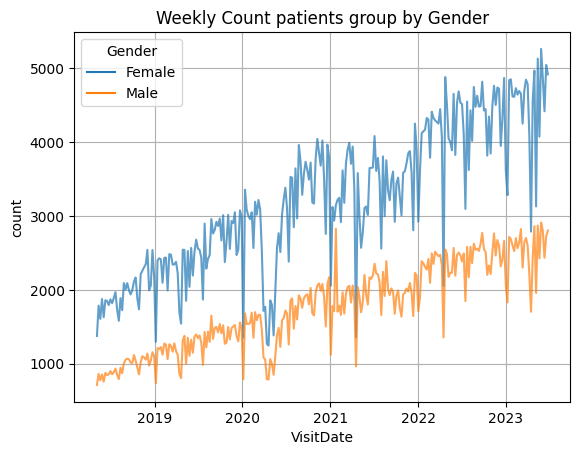

In [6]:
sns.lineplot(data=temp_agg_df.query('VisitDate<"2023-07-01"').replace({'Gender':{2:'Male',1:'Female'}}),x='VisitDate',y='count',hue='Gender',palette='tab10',alpha=0.7).set(title='Weekly Count patients group by Gender')
plt.grid(which='both',axis='both')
plt.savefig("output/weekly_count_patient_group_gender.png",dpi=150)
plt.show()

## Decomposition of Overall Visitdate Count

In [7]:
temp_agg_df=temp_df.groupby([pd.Grouper(key='VisitDate',freq='1D'),"HN","Gender"]).count().reset_index().groupby([pd.Grouper(key='VisitDate',freq='1D')]).agg({'HN':'count'}).rename(columns={'HN':'count'})
# temp_agg_df

C:\Users\900999\AppData\Local\Temp\ipykernel_19440\2262104255.py:7: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


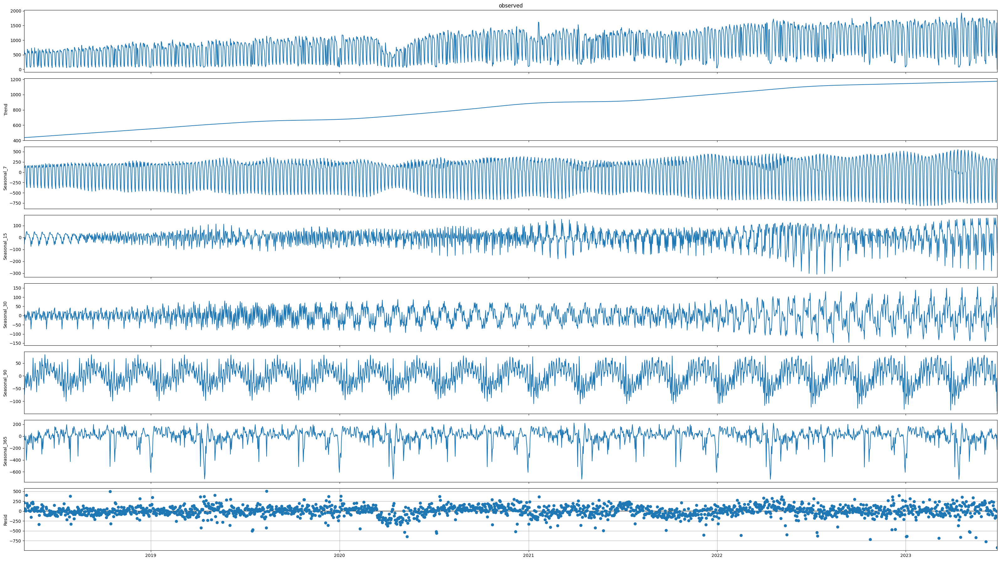

In [8]:
mstl=MSTL(temp_agg_df,periods=(7,15,30,30*3,365),iterate=2,stl_kwargs={'seasonal_deg':0})
res=mstl.fit()

fig=res.plot()
# fig.set_size_inches((22,12))
fig.set_size_inches((32,18))
fig.tight_layout()
plt.grid()
plt.savefig("output/observe_decomposition_multi.png",dpi=150)
plt.show()

## Average of count VN_IN in 2022, groupby weekday

In [9]:
temp_df=pd.merge(patient_info_df.reset_index()[['HN','Gender']],opd_header_df.reset_index(),how='inner',on='HN')[['HN','Gender','InDateTime']]
temp_df=temp_df[temp_df['InDateTime'].dt.year==2022]
temp_df['InDateTime_date']=temp_df.InDateTime.dt.date
temp_df['InDateTime_dayname']=temp_df.InDateTime.dt.day_name()
temp_df['InDateTime_onworkday']=temp_df['InDateTime_dayname'].map(lambda x: x not in {'Saturday','Sunday'})
temp_df['InDateTime_hour']=temp_df.InDateTime.dt.hour
temp_df['counter']=1
# temp_df

In [10]:
temp_agg_df=temp_df.groupby(['InDateTime_date','InDateTime_onworkday','InDateTime_hour']).agg({'counter':'sum'}).reset_index()
temp_agg_df

,InDateTime_date,InDateTime_onworkday,InDateTime_hour,counter
0,2022-01-01,False,3,1
1,2022-01-01,False,7,3
2,2022-01-01,False,8,1
3,2022-01-01,False,9,7
4,2022-01-01,False,10,5
...,...,...,...,...
7243,2022-12-31,False,16,2
7244,2022-12-31,False,17,3
7245,2022-12-31,False,19,1
7246,2022-12-31,False,20,1


In [11]:
temp_template_idx=pd.MultiIndex.from_product([np.arange(np.datetime64('2022-01-01'),np.datetime64('2023-01-01')),np.arange(0,24)],names=['InDateTime_date','InDateTime_hour'])
temp_template_df=pd.DataFrame(index=temp_template_idx).reset_index()
temp_template_df['InDateTime_date']=pd.to_datetime(temp_template_df['InDateTime_date']).dt.date
temp_template_df

,InDateTime_date,InDateTime_hour
0,2022-01-01,0
1,2022-01-01,1
2,2022-01-01,2
3,2022-01-01,3
4,2022-01-01,4
...,...,...
8755,2022-12-31,19
8756,2022-12-31,20
8757,2022-12-31,21
8758,2022-12-31,22


In [12]:
temp_agg_df=temp_template_df.merge(temp_agg_df,on=['InDateTime_date','InDateTime_hour'],how='left')
temp_agg_df['InDateTime_dayname']=pd.to_datetime(temp_agg_df['InDateTime_date']).dt.day_name()
temp_agg_df['InDateTime_onworkday']=temp_agg_df['InDateTime_dayname'].map(lambda x: x not in {'Saturday','Sunday'})
temp_agg_df['counter']=temp_agg_df['counter'].fillna(0)
temp_agg_df

,InDateTime_date,InDateTime_hour,InDateTime_onworkday,counter,InDateTime_dayname
0,2022-01-01,0,False,0.0,Saturday
1,2022-01-01,1,False,0.0,Saturday
2,2022-01-01,2,False,0.0,Saturday
3,2022-01-01,3,False,1.0,Saturday
4,2022-01-01,4,False,0.0,Saturday
...,...,...,...,...,...
8755,2022-12-31,19,False,1.0,Saturday
8756,2022-12-31,20,False,1.0,Saturday
8757,2022-12-31,21,False,0.0,Saturday
8758,2022-12-31,22,False,1.0,Saturday


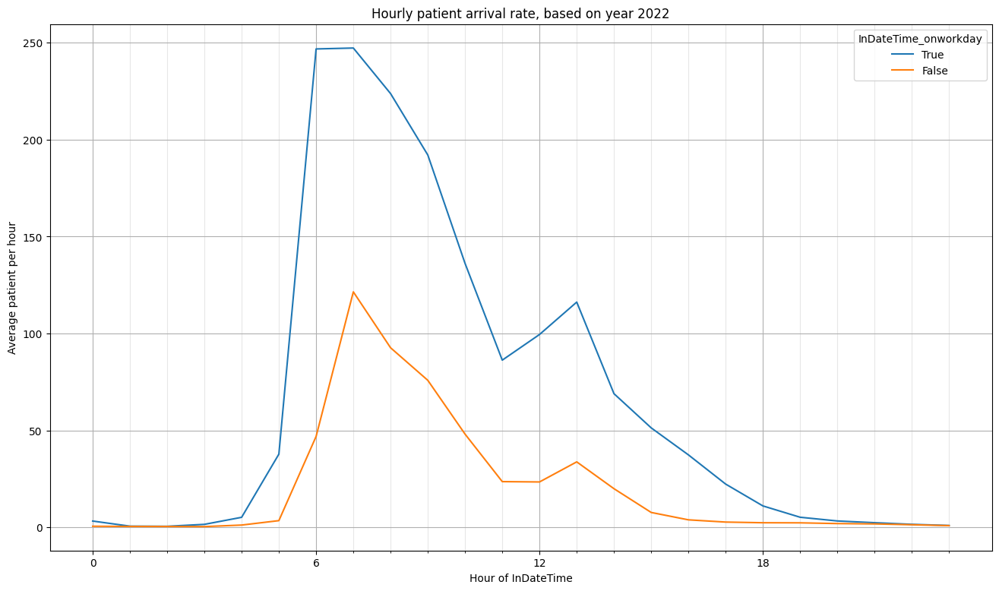

In [13]:
view_temp_agg_df=temp_agg_df.groupby(['InDateTime_onworkday','InDateTime_hour']).agg({'counter':'mean'}).reset_index()
view_temp_agg_df.to_parquet("output/hourly_patient_arrival_rate.parquet")

fig, ax = plt.subplots(1,figsize=(16,9))
sns.lineplot(data=view_temp_agg_df,x='InDateTime_hour',y='counter',hue='InDateTime_onworkday',hue_order=[True,False],ax=ax)
ax.set_xticks(np.arange(0,24,6))
ax.set_xticks(np.arange(0, 24, 1),minor=True)
ax.grid(which='major')
ax.grid(which='minor',alpha=0.3)
ax.set_ylabel("Average patient per hour")
ax.set_xlabel("Hour of InDateTime")
ax.set_title("Hourly patient arrival rate, based on year 2022")
plt.savefig("output/hourly_patient_arrival_rate_2022.png",dpi=150)
plt.show()

## List of all ICDCode that related to patient in this study

In [14]:
temp_df=patient_info_df.reset_index().merge(opd_header_df.reset_index(),on="HN",how='inner').merge(opd_diag_df.reset_index(),on=['VisitDate','VN','PrescriptionNo'])
temp_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
0,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-05-23,2062,...,None,None,None,None,None,None,None,None,None,1
1,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-05-30,2043,...,None,None,None,None,None,None,None,None,None,1
2,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-06-06,2141,...,None,None,None,None,None,None,None,None,None,1
3,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-07-12,2109,...,None,None,None,None,None,None,None,None,None,1
4,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-08-30,2118,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2720988,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-04-28,0667,...,None,None,None,None,None,None,None,None,None,1
2720989,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,1
2720990,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,5
2720991,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-08-25,0876,...,None,None,None,None,None,None,None,None,None,1


In [15]:
temp_agg_df=temp_df.groupby(['HN','ICDCode']).MakeDateTime.apply(lambda x:1).reset_index().groupby('ICDCode').MakeDateTime.sum().reset_index().rename(columns={'MakeDateTime':'count'})
temp_agg_df

,ICDCode,count
0,A00,1
1,A000,1
2,A010,4
3,A014,1
4,A020,1
...,...,...
7094,Z975,1
7095,Z988,71
7096,Z991,1
7097,Z992,28


In [16]:
view_temp_agg_df=temp_agg_df.sort_values('count',ascending=False).head(100)
view_temp_agg_df['%proportion']=view_temp_agg_df['count']/len(patient_info_df)*100
view_temp_agg_df.merge(master_icd_df.reset_index()[['IcdCode','EnglishName']],how='left',left_on='ICDCode',right_on='IcdCode').to_excel("output/list_topn_icd.xlsx")

In [17]:
temp_df[(temp_df['VisitDate']=='2019-09-03')&(temp_df['HN']=='530044802')][['HN','VisitDate','ICDCode','IcdCmCode1','InDateTime','OutDateTime']]

,HN,VisitDate,ICDCode,IcdCmCode1,InDateTime,OutDateTime
895,530044802,2019-09-03,C502,9224,2019-09-03 13:33:46,2019-09-03 21:57:00
896,530044802,2019-09-03,M-85203,None,2019-09-03 13:33:46,2019-09-03 21:57:00
897,530044802,2019-09-03,Z510,None,2019-09-03 13:33:46,2019-09-03 21:57:00


## List of all ICDCode that related to patient in this study, only visitdate year 2022

In [18]:
temp_df=patient_info_df.reset_index().merge(opd_header_df.reset_index(),on="HN",how='inner').merge(opd_diag_df.reset_index(),on=['VisitDate','VN','PrescriptionNo'])
temp_df=temp_df[temp_df['VisitDate'].dt.year==2022]
temp_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
33,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-10,1455,...,None,None,None,None,None,None,None,None,None,1
34,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-31,0058,...,None,None,None,None,None,None,None,None,None,1
35,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,1
36,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,5
37,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-11,0757,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2720988,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-04-28,0667,...,None,None,None,None,None,None,None,None,None,1
2720989,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,1
2720990,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,5
2720991,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-08-25,0876,...,None,None,None,None,None,None,None,None,None,1


In [19]:
temp_agg_df=temp_df.groupby(['HN','ICDCode']).MakeDateTime.apply(lambda x:1).reset_index().groupby('ICDCode').MakeDateTime.sum().reset_index().rename(columns={'MakeDateTime':'count'})
temp_agg_df

,ICDCode,count
0,A000,1
1,A021,1
2,A028,2
3,A047,4
4,A049,7
...,...,...
4626,Z9661,1
4627,Z968,1
4628,Z975,1
4629,Z988,14


In [20]:
view_temp_agg_df=temp_agg_df.sort_values('count',ascending=False).head(100)
view_temp_agg_df['%proportion']=view_temp_agg_df['count']/len(patient_info_df)*100
view_temp_agg_df.merge(master_icd_df.reset_index()[['IcdCode','EnglishName']],how='left',left_on='ICDCode',right_on='IcdCode').to_excel("output/list_topn_icd_visityear_2022.xlsx")

## Try to summarise any visit including with top100 ICDCode only year 2022

### Try to extract all visit ICD which were same time as top 100 ICD

In [21]:
topn_icd_visityear_2022_df=pd.read_excel("output/list_topn_icd_visityear_2022.xlsx",index_col=0,nrows=10)
topn_icd_visityear_2022_df

,ICDCode,count,%proportion,IcdCode,EnglishName
0,Z115,24633,6.889348,Z115,Special screening examination for other viral ...
1,Z290,11880,3.322594,Z290,Isolation ...
2,U071,10153,2.839587,U071,"COVID-19, virus identified"
3,E789,8713,2.436848,E789,"Disorder of lipoprotein metabolism, unspecifie..."
4,U072,8416,2.353784,U072,"COVID-19, virus not identified"
5,I10,7543,2.109623,I10,Essential (primary) hypertension ...
6,Z532,5187,1.450698,Z532,Procedure not carried out because of patient's...
7,Z000,4780,1.336868,Z000,General medical examination ...
8,J00,4373,1.223039,J00,Acute nasopharyngitis [common cold]
9,H041,4236,1.184723,H041,Other disorders of lacrimal gland ...


In [22]:
set_topn_icd_visityear_2022=set(topn_icd_visityear_2022_df['ICDCode'])
# set_topn_icd_visityear_2022

In [23]:
temp_df=patient_info_df.reset_index().merge(opd_header_df.reset_index(),on="HN",how='inner').merge(opd_diag_df[opd_diag_df['ICDCode'].map(lambda x: x in set_topn_icd_visityear_2022)].reset_index(),on=['VisitDate','VN','PrescriptionNo'])
temp_df=temp_df[temp_df['VisitDate'].dt.year==2022]
temp_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
6,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-10,1455,...,None,None,None,None,None,None,None,None,None,1
7,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-31,0058,...,None,None,None,None,None,None,None,None,None,1
8,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,5
9,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-11,0757,...,None,None,None,None,None,None,None,None,None,1
10,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-14,0684,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416928,530042216,2010-09-10 18:32:29,2010-09-10 18:32:29,1950-08-14 00:00:00.060,NaT,1,1,099,2022-03-09,T0046,...,None,None,None,None,None,None,None,None,None,5
416929,530042216,2010-09-10 18:32:29,2010-09-10 18:32:29,1950-08-14 00:00:00.060,NaT,1,1,099,2022-03-09,T0046,...,None,None,None,None,None,None,None,None,None,5
416930,530042216,2010-09-10 18:32:29,2010-09-10 18:32:29,1950-08-14 00:00:00.060,NaT,1,1,099,2022-07-27,0325,...,None,None,None,None,None,None,None,None,None,5
416945,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5


In [24]:
temp_inspect_visit_df=temp_df[['HN','VisitDate','VN','PrescriptionNo']].drop_duplicates()

In [25]:
temp_df=patient_info_df.reset_index().merge(opd_header_df.reset_index(),on="HN",how='inner').merge(opd_diag_df.reset_index(),on=['VisitDate','VN','PrescriptionNo'])
temp_df=temp_df[temp_df['VisitDate'].dt.year==2022]
temp_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
33,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-10,1455,...,None,None,None,None,None,None,None,None,None,1
34,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-31,0058,...,None,None,None,None,None,None,None,None,None,1
35,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,1
36,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,5
37,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-11,0757,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2720988,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-04-28,0667,...,None,None,None,None,None,None,None,None,None,1
2720989,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,1
2720990,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,5
2720991,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-08-25,0876,...,None,None,None,None,None,None,None,None,None,1


In [26]:
visit_related_topn_icd_df=temp_df.merge(temp_inspect_visit_df.drop(columns=['HN']),how='inner',on=['VisitDate','VN','PrescriptionNo'])
visit_related_topn_icd_df.to_parquet("output/visit_related_topn_icd_df.parquet")
visit_related_topn_icd_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
0,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-10,1455,...,None,None,None,None,None,None,None,None,None,1
1,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-31,0058,...,None,None,None,None,None,None,None,None,None,1
2,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,1
3,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,5
4,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-11,0757,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232226,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5
232227,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5
232228,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5
232229,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5


### Try to create Graph for ICD relation

In [27]:
visit_related_topn_icd_df=pd.read_parquet("output/visit_related_topn_icd_df.parquet")
visit_related_topn_icd_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
0,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-10,1455,...,None,None,None,None,None,None,None,None,None,1
1,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-31,0058,...,None,None,None,None,None,None,None,None,None,1
2,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,1
3,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,5
4,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-11,0757,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232226,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5
232227,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5
232228,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5
232229,530042864,2010-09-13 19:30:29,2010-09-13 19:30:29,1961-12-07 00:00:00.060,NaT,2,2,099,2022-10-10,0711,...,None,None,None,None,None,None,None,None,None,5


In [28]:
agg_visit_related_topn_icd_df=visit_related_topn_icd_df.groupby(['VisitDate','VN','PrescriptionNo']).agg({'ICDCode':set}).reset_index()
agg_visit_related_topn_icd_df

,VisitDate,VN,PrescriptionNo,ICDCode
0,2022-01-01,0020,1,{Z115}
1,2022-01-01,0030,1,{Z115}
2,2022-01-01,0037,1,{Z115}
3,2022-01-01,0046,1,"{I10, R42}"
4,2022-01-01,0049,1,{Z115}
...,...,...,...,...
105680,2022-12-31,0091,1,"{J00, M6269}"
105681,2022-12-31,0092,1,"{Z115, J00}"
105682,2022-12-31,0093,1,"{Z115, J00}"
105683,2022-12-31,0094,1,"{Z290, Z115, U072}"


In [29]:
node_edge_dict=dict()

for set_icd in tqdm(agg_visit_related_topn_icd_df['ICDCode'].values):
    list_icd=sorted(list(set_icd))
    if len(list_icd)==1: #self loop
        # if not node_edge_dict.get(tuple([list_icd[0],list_icd[0]])):
        #     node_edge_dict[tuple([list_icd[0],list_icd[0]])]=dict(weight=0)
        # node_edge_dict[tuple([list_icd[0],list_icd[0]])]['weight']=node_edge_dict[tuple([list_icd[0],list_icd[0]])]['weight']+1
        continue;
    for comb in combinations(list_icd,2):
        if not node_edge_dict.get(tuple(comb)):
            node_edge_dict[tuple(comb)]=dict(weight=0)
        node_edge_dict[tuple(comb)]['weight']=node_edge_dict[tuple(comb)]['weight']+1

  0%|          | 0/105685 [00:00<?, ?it/s]

In [30]:
node_edge_df=pd.DataFrame.from_dict(node_edge_dict).transpose().reset_index()
G=nx.from_pandas_edgelist(node_edge_df,"level_0","level_1",["weight"],create_using=nx.Graph())
nx.write_graphml_lxml(G,"output/network_icd_visityear_2022.graphml")

## List of all ICDCM code that related to patients

In [31]:
temp_df=patient_info_df.reset_index().merge(opd_header_df.reset_index(),on="HN",how='inner').merge(opd_diag_df.reset_index(),on=['VisitDate','VN','PrescriptionNo'])
temp_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
0,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-05-23,2062,...,None,None,None,None,None,None,None,None,None,1
1,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-05-30,2043,...,None,None,None,None,None,None,None,None,None,1
2,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-06-06,2141,...,None,None,None,None,None,None,None,None,None,1
3,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-07-12,2109,...,None,None,None,None,None,None,None,None,None,1
4,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2018-08-30,2118,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2720988,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-04-28,0667,...,None,None,None,None,None,None,None,None,None,1
2720989,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,1
2720990,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,5
2720991,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-08-25,0876,...,None,None,None,None,None,None,None,None,None,1


In [32]:
temp_index_df=temp_df.set_index(['HN','MakeDateTime','VisitDate','VN','PrescriptionNo','SuffixSmall','ICDCode'])[[f'IcdCmCode{i}' for i in range(1,11)]]
temp_index_df[[f'IcdCmCode{i}' for i in range(1,11)]]=temp_index_df[[f'IcdCmCode{i}' for i in range(1,11)]].astype(str).replace('None',None)
temp_index_df=temp_index_df.melt(ignore_index=False,value_name='IcdCmCode').dropna(subset='IcdCmCode')

In [33]:
temp_agg_df=temp_index_df.reset_index().groupby(['HN','ICDCode','VisitDate','IcdCmCode']).MakeDateTime.apply(lambda x:1).reset_index().groupby(['ICDCode','IcdCmCode']).MakeDateTime.sum().reset_index().rename(columns={'MakeDateTime':'count'})
temp_agg_df

,ICDCode,IcdCmCode,count
0,A000,8744,1
1,A000,8952,1
2,A010,9053,1
3,A021,8823,1
4,A021,9214,1
...,...,...,...
42938,Z991,3142,1
42939,Z991,8744,1
42940,Z992,3995,9
42941,Z992,8744,1


In [34]:
view_temp_agg_df=temp_agg_df.sort_values('count',ascending=False).head(100)
view_temp_agg_df['%proportion']=view_temp_agg_df['count']/len(patient_info_df)*100
view_temp_agg_df.merge(master_icd_df.reset_index()[['IcdCode','EnglishName']].rename(columns={'EnglishName':'ICDDescription'}),how='left',left_on='ICDCode',right_on='IcdCode').merge(master_icd_cm_df.reset_index()[['IcdCmCode','EnglishName']].rename(columns={'EnglishName':'ICDCmDescription'}),how='left',on='IcdCmCode').to_excel("output/list_topn_icd_icdcm.xlsx")

## List of all ICDCM code that related to patients in 2022

In [35]:
temp_df=patient_info_df.reset_index().merge(opd_header_df.reset_index(),on="HN",how='inner').merge(opd_diag_df.reset_index(),on=['VisitDate','VN','PrescriptionNo'])
temp_df=temp_df[temp_df['VisitDate'].dt.year==2022]
temp_df

,HN,MakeDateTime,FirstDateTime,BirthDateTime,DeadDateTime,Gender,MaritalStatus,NationalityCode,VisitDate,VN,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
33,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-10,1455,...,None,None,None,None,None,None,None,None,None,1
34,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-01-31,0058,...,None,None,None,None,None,None,None,None,None,1
35,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,1
36,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-02-22,0600,...,None,None,None,None,None,None,None,None,None,5
37,530043115,2010-09-14 18:25:12,2010-09-14 18:25:12,1984-10-02 00:00:00.060,NaT,1,1,099,2022-03-11,0757,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2720988,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-04-28,0667,...,None,None,None,None,None,None,None,None,None,1
2720989,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,1
2720990,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-05-24,0954,...,None,None,None,None,None,None,None,None,None,5
2720991,530043002,2010-09-14 09:21:02,2010-09-14 09:21:02,1951-11-29 00:00:00.060,NaT,1,2,099,2022-08-25,0876,...,None,None,None,None,None,None,None,None,None,1


In [36]:
temp_index_df=temp_df.set_index(['HN','MakeDateTime','VisitDate','VN','PrescriptionNo','SuffixSmall','ICDCode'])[[f'IcdCmCode{i}' for i in range(1,11)]]
temp_index_df[[f'IcdCmCode{i}' for i in range(1,11)]]=temp_index_df[[f'IcdCmCode{i}' for i in range(1,11)]].astype(str).replace('None',None)
temp_index_df=temp_index_df.melt(ignore_index=False,value_name='IcdCmCode').dropna(subset='IcdCmCode')

In [37]:
temp_agg_df=temp_index_df.reset_index().groupby(['HN','ICDCode','VisitDate','IcdCmCode']).MakeDateTime.apply(lambda x:1).reset_index().groupby(['ICDCode','IcdCmCode']).MakeDateTime.sum().reset_index().rename(columns={'MakeDateTime':'count'})
temp_agg_df

,ICDCode,IcdCmCode,count
0,A000,8744,1
1,A000,8952,1
2,A021,9952,1
3,A047,8744,1
4,A047,8952,1
...,...,...,...
19767,Z968,9701,3
19768,Z988,8659,1
19769,Z988,8911,1
19770,Z988,9503,1


In [38]:
view_temp_agg_df=temp_agg_df.sort_values('count',ascending=False).head(100)
view_temp_agg_df['%proportion']=view_temp_agg_df['count']/len(patient_info_df)*100
view_temp_agg_df.merge(master_icd_df.reset_index()[['IcdCode','EnglishName']].rename(columns={'EnglishName':'ICDDescription'}),how='left',left_on='ICDCode',right_on='IcdCode').merge(master_icd_cm_df.reset_index()[['IcdCmCode','EnglishName']].rename(columns={'EnglishName':'ICDCmDescription'}),how='left',on='IcdCmCode').to_excel("output/list_topn_icd_icdcm_visityear_2022.xlsx")

## Try to summarize any ICD which included topn ICDCm

In [39]:
opd_diag_melt_df=opd_diag_df.reset_index().set_index(['VisitDate','VN','PrescriptionNo','SuffixSmall','ICDCode']).drop(columns=['ECode','DiagnosisRecordType']).astype(str).melt(value_name='IcdCmCode',ignore_index=False).drop(columns=['variable']).replace('None',None).dropna(subset=['IcdCmCode'])
opd_diag_melt_df

IcdCmCode
VisitDate  VN   PrescriptionNo SuffixSmall ICDCode          
2018-01-01 003  1              1           Z480         9357
           005  1              1           Z480         9357
           006  1              1           Z480         9357
           013  1              1           C539         9357
           014  1              1           S810         9357
...                                                      ...
2023-06-24 0638 1              1           N800         6739
2023-06-25 0035 1              1           R194         9113
           0133 1              1           H353         9503
           0253 1              1           H259         9509
                2              1           H259         9509

[1277111 rows x 1 columns]

In [40]:
topn_icd_icdcm_visityear_2022_df=pd.read_excel("output/list_topn_icd_icdcm_visityear_2022.xlsx",index_col=0)
topn_icd_icdcm_visityear_2022_df['IcdCmCode']=topn_icd_icdcm_visityear_2022_df['IcdCmCode'].astype(str)
set_topn_icdcm_visityear_2022=set(topn_icd_icdcm_visityear_2022_df['IcdCmCode'].unique().tolist())
set_topn_icdcm_visityear_2022

{'232',
 '8741',
 '8744',
 '8801',
 '8827',
 '8879',
 '8891',
 '8911',
 '8926',
 '8952',
 '9039',
 '9149',
 '9224',
 '9336',
 '9339',
 '9357',
 '9503',
 '9509',
 '9511',
 '9654',
 '9925',
 '9991',
 '9992'}

In [41]:
opd_diag_melt_filter_df=opd_diag_melt_df[opd_diag_melt_df['IcdCmCode'].map(lambda x:x in set_topn_icdcm_visityear_2022)]
opd_diag_melt_filter_df=opd_diag_melt_filter_df.reset_index()[opd_diag_melt_filter_df.reset_index()['VisitDate'].dt.year==2022]

In [42]:
opd_filtered_df=opd_header_df.reset_index().merge(opd_diag_melt_filter_df[['VisitDate','VN','PrescriptionNo']],on=['VisitDate','VN','PrescriptionNo']).merge(opd_diag_df.reset_index(),on=['VisitDate','VN','PrescriptionNo'])
opd_filtered_df

,VisitDate,VN,PrescriptionNo,HN,NewToHere,NewPatient,Doctor,VisitCode,CloseVisitCode,RightCode,...,IcdCmCode2,IcdCmCode3,IcdCmCode4,IcdCmCode5,IcdCmCode6,IcdCmCode7,IcdCmCode8,IcdCmCode9,IcdCmCode10,DiagnosisRecordType
0,2022-01-01,0011,1,640250405,0,0,ER20021,01,001,4103,...,9169,9357,None,None,None,None,None,None,None,1
1,2022-01-01,0011,1,640250405,0,0,ER20021,01,001,4103,...,None,None,None,None,None,None,None,None,None,6
2,2022-01-01,0020,1,650000038,1,1,00,01,002,1000,...,None,None,None,None,None,None,None,None,None,1
3,2022-01-01,0030,1,620055628,2,0,56119,03,014,2103,...,None,None,None,None,None,None,None,None,None,1
4,2022-01-01,0036,1,640485482,0,0,ER19016,01,002,4000,...,None,None,None,None,None,None,None,None,None,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
377749,2022-12-31,0099,1,650228722,0,0,57621,02,001,4000,...,None,None,None,None,None,None,None,None,None,5
377750,2022-12-31,0099,1,650228722,0,0,57621,02,001,4000,...,None,None,None,None,None,None,None,None,None,5
377751,2022-12-31,0101,1,650584088,1,1,57621,03,002,1000,...,None,None,None,None,None,None,None,None,None,1
377752,2022-12-31,0102,1,650552067,0,0,ER20019,05,001,2107,...,8879,None,None,None,None,None,None,None,None,1


In [43]:
opd_filtered_melt_df=opd_filtered_df.melt(id_vars=opd_filtered_df.drop(columns=[f'IcdCmCode{i}' for i in range(1,11)]).columns,value_vars=[f'IcdCmCode{i}' for i in range(1,11)],value_name='IcdCmCode')
opd_filtered_melt_df

,VisitDate,VN,PrescriptionNo,HN,NewToHere,NewPatient,Doctor,VisitCode,CloseVisitCode,RightCode,...,AppointmentDateTime,InDateTime,OutDateTime,SpecialtyClinic,SuffixSmall,ICDCode,ECode,DiagnosisRecordType,variable,IcdCmCode
0,2022-01-01,0011,1,640250405,0,0,ER20021,01,001,4103,...,NaT,2022-01-01 07:18:23.000,2022-01-01 08:14:00,901,1,C19,None,1,IcdCmCode1,9163
1,2022-01-01,0011,1,640250405,0,0,ER20021,01,001,4103,...,NaT,2022-01-01 07:18:23.000,2022-01-01 08:14:00,901,2,M-81403,None,6,IcdCmCode1,None
2,2022-01-01,0020,1,650000038,1,1,00,01,002,1000,...,NaT,2022-01-01 10:17:40.000,2022-01-01 11:57:00,901,1,Z115,None,1,IcdCmCode1,9039
3,2022-01-01,0030,1,620055628,2,0,56119,03,014,2103,...,NaT,2022-01-01 13:49:21.000,2022-01-01 21:34:00,901,1,Z115,None,1,IcdCmCode1,9039
4,2022-01-01,0036,1,640485482,0,0,ER19016,01,002,4000,...,NaT,2022-01-01 15:44:06.000,2022-01-03 08:17:00,901,1,C220,None,1,IcdCmCode1,9357
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3777535,2022-12-31,0099,1,650228722,0,0,57621,02,001,4000,...,NaT,2022-12-31 16:36:44.757,2022-12-31 19:37:00,None,4,E871,None,5,IcdCmCode10,None
3777536,2022-12-31,0099,1,650228722,0,0,57621,02,001,4000,...,NaT,2022-12-31 16:36:44.757,2022-12-31 19:37:00,None,5,Z115,None,5,IcdCmCode10,None
3777537,2022-12-31,0101,1,650584088,1,1,57621,03,002,1000,...,NaT,2022-12-31 17:27:53.000,2022-12-31 18:09:00,921,1,R55,None,1,IcdCmCode10,None
3777538,2022-12-31,0102,1,650552067,0,0,ER20019,05,001,2107,...,NaT,2022-12-31 17:42:01.253,2022-12-31 19:48:00,None,1,M549,None,1,IcdCmCode10,None


In [44]:
opd_filtered_melt_df[~opd_filtered_melt_df['IcdCmCode'].isna()].drop_duplicates().to_parquet("output/opd_filtered_melt_df.parquet")
opd_filtered_melt_df[opd_filtered_melt_df['IcdCmCode'].isna()].drop_duplicates().to_parquet("output/opd_filtered_melt_df_na_icdcm.parquet")

### Create Dummy Table to fill needed facility

In [45]:
facility_needed_df=pd.DataFrame()

In [46]:
facility_needed_df['IcdCmCode']=opd_filtered_melt_df[~opd_filtered_melt_df['IcdCmCode'].isna()]['IcdCmCode'].unique()
facility_needed_df=facility_needed_df.merge(master_icd_cm_df.reset_index()[['IcdCmCode','EnglishName','RemarksMemo']])
facility_needed_df[['need_opd','need_er','need_lab','need_or_room','need_radio','need_orthopedics','need_dermatology','need_neurology','need_dental','need_ophthalmology','need_otolaryngology','need_thoracic_department','need_hematology','need_gi_liver_department','need_gynaecologty','need_nephrology_department','need_pharmacy','need_ipd_stay','need_icu_stay','need_physical_theraputic_room','completed']]=0

In [47]:
facility_needed_df.to_excel("input_data/[template]facility_needed_df.xlsx",index=False)

# Inspect on facility_need, re-map into patient visit transactions

In [48]:
facility_needed_df=pd.read_excel("input_data/facility_needed_df.xlsx",dtype={'IcdCmCode':str}).replace(0.5,1)
facility_needed_df=facility_needed_df.astype({'need_opd':int,'need_er':int,'need_or_room':int})
facility_needed_df.iloc[:,3:]=facility_needed_df.iloc[:,3:].astype(bool)
facility_needed_df

,IcdCmCode,EnglishName,RemarksMemo,need_opd,need_er,need_lab,need_or_room,need_radio,need_orthopedics,need_dermatology,...,need_thoracic_department,need_hematology,need_gi_liver_department,need_gynaecology,need_nephrology_department,need_pharmacy,need_ipd_stay,need_icu_stay,need_physical_theraputic_room,completed
0,9163,Microscopic examination of specimen from skin ...,Microscopic exmination,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
1,9039,"Microscopic examination of specimen from ear, ...",NaN,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
2,9357,Application of other wound dressing,NaN,False,True,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,True
3,8744,"Routine chest x-ray, so described",X-ray of chest,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,True
4,8952,Electrocardiogram,ECG NOS\nEKG (with 12 or more,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,9909,Transfusion of other substance,Transfusion of:\nblood,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,True
446,9111,Microscopic examination of peritoneal and retr...,NaN,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
447,3423,Biopsy of chest wall,NaN,False,False,False,False,False,False,False,...,True,False,False,False,False,False,False,False,False,True
448,1473,Mechanical vitrectomy by anterior approach,NaN,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,True


In [49]:
opd_filtered_melt_df=pd.concat([pd.read_parquet("output/opd_filtered_melt_df.parquet"),pd.read_parquet("output/opd_filtered_melt_df_na_icdcm.parquet")],ignore_index=True)
opd_filtered_melt_df

,VisitDate,VN,PrescriptionNo,HN,NewToHere,NewPatient,Doctor,VisitCode,CloseVisitCode,RightCode,...,AppointmentDateTime,InDateTime,OutDateTime,SpecialtyClinic,SuffixSmall,ICDCode,ECode,DiagnosisRecordType,variable,IcdCmCode
0,2022-01-01,0011,1,640250405,0,0,ER20021,01,001,4103,...,NaT,2022-01-01 07:18:23.000,2022-01-01 08:14:00,901,1,C19,None,1,IcdCmCode1,9163
1,2022-01-01,0020,1,650000038,1,1,00,01,002,1000,...,NaT,2022-01-01 10:17:40.000,2022-01-01 11:57:00,901,1,Z115,None,1,IcdCmCode1,9039
2,2022-01-01,0030,1,620055628,2,0,56119,03,014,2103,...,NaT,2022-01-01 13:49:21.000,2022-01-01 21:34:00,901,1,Z115,None,1,IcdCmCode1,9039
3,2022-01-01,0036,1,640485482,0,0,ER19016,01,002,4000,...,NaT,2022-01-01 15:44:06.000,2022-01-03 08:17:00,901,1,C220,None,1,IcdCmCode1,9357
4,2022-01-01,0037,1,640499842,2,0,57621,01,014,5100,...,NaT,2022-01-01 16:00:23.000,2022-01-07 10:31:00,901,1,Z115,None,1,IcdCmCode1,9039
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2851405,2022-12-31,0099,1,650228722,0,0,57621,02,001,4000,...,NaT,2022-12-31 16:36:44.757,2022-12-31 19:37:00,None,4,E871,None,5,IcdCmCode10,None
2851406,2022-12-31,0099,1,650228722,0,0,57621,02,001,4000,...,NaT,2022-12-31 16:36:44.757,2022-12-31 19:37:00,None,5,Z115,None,5,IcdCmCode10,None
2851407,2022-12-31,0101,1,650584088,1,1,57621,03,002,1000,...,NaT,2022-12-31 17:27:53.000,2022-12-31 18:09:00,921,1,R55,None,1,IcdCmCode10,None
2851408,2022-12-31,0102,1,650552067,0,0,ER20019,05,001,2107,...,NaT,2022-12-31 17:42:01.253,2022-12-31 19:48:00,None,1,M549,None,1,IcdCmCode10,None


In [50]:
opd_merge_df=opd_filtered_melt_df.merge(facility_needed_df,how='left')
facility_col=opd_merge_df.columns[opd_merge_df.columns.str.startswith("need")]

opd_labelled_df=opd_merge_df.groupby(['VisitDate','VN','PrescriptionNo','HN'],dropna=False).agg(dict(zip(facility_col,['any']*facility_col.shape[0]))).reset_index()
opd_labelled_df

,VisitDate,VN,PrescriptionNo,HN,need_opd,need_er,need_lab,need_or_room,need_radio,need_orthopedics,...,need_otolaryngology,need_thoracic_department,need_hematology,need_gi_liver_department,need_gynaecology,need_nephrology_department,need_pharmacy,need_ipd_stay,need_icu_stay,need_physical_theraputic_room
0,2022-01-01,0011,1,640250405,False,True,True,True,False,False,...,False,False,False,False,False,False,False,False,False,False
1,2022-01-01,0020,1,650000038,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,2022-01-01,0030,1,620055628,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,2022-01-01,0036,1,640485482,False,True,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
4,2022-01-01,0037,1,640499842,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133069,2022-12-31,0098,1,650500549,False,False,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
133070,2022-12-31,0099,1,650228722,False,False,True,False,True,False,...,False,False,False,False,False,False,False,False,False,False
133071,2022-12-31,0101,1,650584088,True,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
133072,2022-12-31,0102,1,650552067,False,False,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False


In [51]:
opd_final_df=opd_header_df.reset_index()[['VisitDate','VN','PrescriptionNo','HN','InDateTime','OutDateTime']].merge(opd_labelled_df)
opd_final_df

,VisitDate,VN,PrescriptionNo,HN,InDateTime,OutDateTime,need_opd,need_er,need_lab,need_or_room,...,need_otolaryngology,need_thoracic_department,need_hematology,need_gi_liver_department,need_gynaecology,need_nephrology_department,need_pharmacy,need_ipd_stay,need_icu_stay,need_physical_theraputic_room
0,2022-01-01,0011,1,640250405,2022-01-01 07:18:23.000,2022-01-01 08:14:00,False,True,True,True,...,False,False,False,False,False,False,False,False,False,False
1,2022-01-01,0020,1,650000038,2022-01-01 10:17:40.000,2022-01-01 11:57:00,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
2,2022-01-01,0030,1,620055628,2022-01-01 13:49:21.000,2022-01-01 21:34:00,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
3,2022-01-01,0036,1,640485482,2022-01-01 15:44:06.000,2022-01-03 08:17:00,False,True,False,True,...,False,False,False,False,False,False,False,False,False,False
4,2022-01-01,0037,1,640499842,2022-01-01 16:00:23.000,2022-01-07 10:31:00,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133069,2022-12-31,0098,1,650500549,2022-12-31 15:55:33.000,2022-12-31 17:23:00,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
133070,2022-12-31,0099,1,650228722,2022-12-31 16:36:44.757,2022-12-31 19:37:00,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
133071,2022-12-31,0101,1,650584088,2022-12-31 17:27:53.000,2022-12-31 18:09:00,True,True,False,False,...,False,False,False,False,False,False,False,False,False,False
133072,2022-12-31,0102,1,650552067,2022-12-31 17:42:01.253,2022-12-31 19:48:00,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [52]:
opd_final_df['elapsed_time_in_minutes']=(opd_final_df['OutDateTime']-opd_final_df['InDateTime']).dt.total_seconds()/60
opd_final_df['VisitDate_dayofweek']=opd_final_df['VisitDate'].dt.day_name()
opd_final_df['VisitDate_weekend']=opd_final_df['VisitDate_dayofweek'].map(lambda x: x in {'Saturday','Sunday'})
opd_final_df=opd_final_df.drop(columns=['VN','PrescriptionNo','HN','InDateTime','OutDateTime','VisitDate_dayofweek'])
opd_final_df

,VisitDate,need_opd,need_er,need_lab,need_or_room,need_radio,need_orthopedics,need_dermatology,need_neurology,need_dental,...,need_hematology,need_gi_liver_department,need_gynaecology,need_nephrology_department,need_pharmacy,need_ipd_stay,need_icu_stay,need_physical_theraputic_room,elapsed_time_in_minutes,VisitDate_weekend
0,2022-01-01,False,True,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,55.616667,True
1,2022-01-01,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,99.333333,True
2,2022-01-01,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,464.650000,True
3,2022-01-01,False,True,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,2432.900000,True
4,2022-01-01,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,8310.616667,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133069,2022-12-31,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,87.450000,True
133070,2022-12-31,False,False,True,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,180.254050,True
133071,2022-12-31,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,41.116667,True
133072,2022-12-31,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,125.979117,True


In [53]:
opd_final_df.to_parquet("input_data/opd_final_df.parquet")

# Linear regression to estimate process time in the small steps

Based on these assumptions:
- Every patients must be started from OPD and end with Discharge without any deaths (ER not available in this simple simulation).
- Subprocesses must be preformed sequentially and did not have any loopbacks.
- Some subprocesses may be skipped due to unnecessity.
- Process time on weekday and working day may be difference, so try to estimate on separate linear regression models.
- VN_IN were available only in 8 am. to 4 pm. of everydays.
- Distance between departments were insignificantly effected the overall process time, may be skipped consideration on transition time.
- Departments were standed by for 24 hours each day.
- Any workers for each department were equal on performance.

In [54]:
opd_final_df=pd.read_parquet("input_data/opd_final_df.parquet")

## Recheck process time distribution

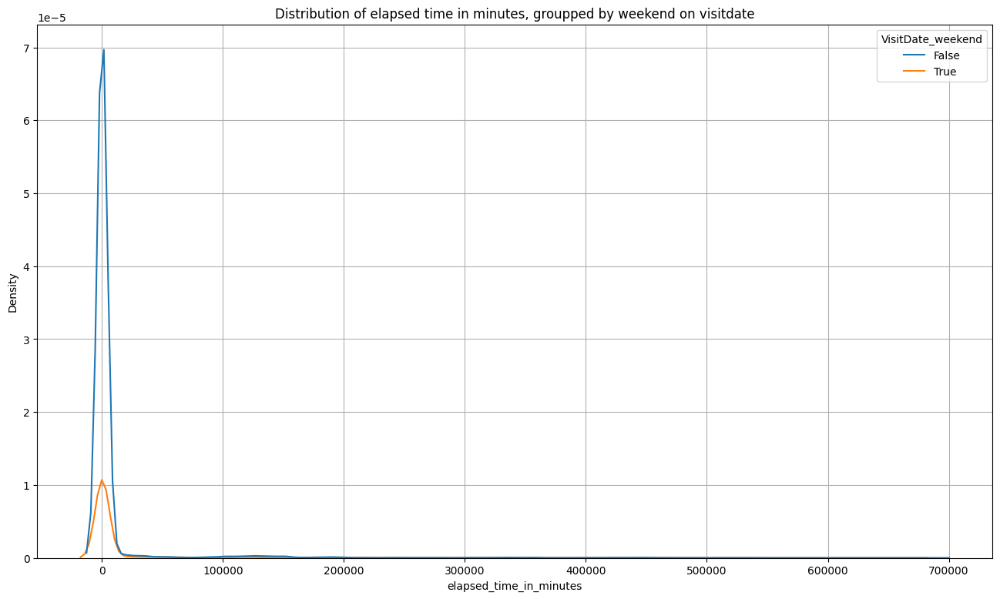

In [55]:
fig, ax = plt.subplots(1,figsize=(16,9))
sns.kdeplot(data=opd_final_df,x='elapsed_time_in_minutes',hue='VisitDate_weekend',ax=ax)
plt.grid()
plt.title("Distribution of elapsed time in minutes, groupped by weekend on visitdate")
plt.savefig("output/histplot_elapsed_time_minutes.png",dpi=150)
plt.show()

## Try Bayesian Model Outside

### on working day

In [154]:
y=opd_final_df['elapsed_time_in_minutes']
X=opd_final_df.drop(columns=['elapsed_time_in_minutes','VisitDate_weekend','VisitDate','need_opd','need_er','need_icu_stay'])

In [161]:
str_equation="elapsed_time_in_minutes~(1|VisitDate_weekend)+"+"+".join(['('+i+'|VisitDate_weekend)' for i in X.columns.tolist()])

In [162]:
str_equation

'elapsed_time_in_minutes~(1|VisitDate_weekend)+(need_lab|VisitDate_weekend)+(need_or_room|VisitDate_weekend)+(need_radio|VisitDate_weekend)+(need_orthopedics|VisitDate_weekend)+(need_dermatology|VisitDate_weekend)+(need_neurology|VisitDate_weekend)+(need_dental|VisitDate_weekend)+(need_ophthalmology|VisitDate_weekend)+(need_otolaryngology|VisitDate_weekend)+(need_thoracic_department|VisitDate_weekend)+(need_hematology|VisitDate_weekend)+(need_gi_liver_department|VisitDate_weekend)+(need_gynaecology|VisitDate_weekend)+(need_nephrology_department|VisitDate_weekend)+(need_pharmacy|VisitDate_weekend)+(need_ipd_stay|VisitDate_weekend)+(need_physical_theraputic_room|VisitDate_weekend)'

In [163]:
model1=bmb.Model(str_equation,opd_final_df,family='t')
model1.build()

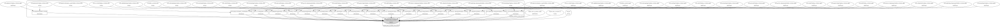

In [164]:
model1.graph()

In [165]:
model1

       Formula: elapsed_time_in_minutes~(1|VisitDate_weekend)+(need_lab|VisitDate_weekend)+(need_or_room|VisitDate_weekend)+(need_radio|VisitDate_weekend)+(need_orthopedics|VisitDate_weekend)+(need_dermatology|VisitDate_weekend)+(need_neurology|VisitDate_weekend)+(need_dental|VisitDate_weekend)+(need_ophthalmology|VisitDate_weekend)+(need_otolaryngology|VisitDate_weekend)+(need_thoracic_department|VisitDate_weekend)+(need_hematology|VisitDate_weekend)+(need_gi_liver_department|VisitDate_weekend)+(need_gynaecology|VisitDate_weekend)+(need_nephrology_department|VisitDate_weekend)+(need_pharmacy|VisitDate_weekend)+(need_ipd_stay|VisitDate_weekend)+(need_physical_theraputic_room|VisitDate_weekend)
        Family: t
          Link: mu = identity
  Observations: 133074
        Priors: 
    target = mu
        Common-level effects
            Intercept ~ Normal(mu: 8117.8036, sigma: 108139.1544)
        
        Group-level effects
            1|VisitDate_weekend ~ Normal(mu: 0.0, sigma: Half